In [2]:
from pydub import AudioSegment
import os

In [3]:
# Get the paths for the data and src dir
current_dir = os.getcwd()
base_dir = os.path.dirname(current_dir)
data_dir = os.path.join(base_dir, 'data')

In [4]:
# Get the paths for all subdirs in data
data_subdir_names = ['ChildrenAudio', 'MaleFemaleAudio', 'NoisyAudio', 'MultipleSpeakers']
data_subdir_paths = []

for name in data_subdir_names:
    data_subdir_paths.append(os.path.join(data_dir, name))

print(data_subdir_paths)


['/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/ChildrenAudio', '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/MaleFemaleAudio', '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio', '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/MultipleSpeakers']


In [5]:
# Function to get the sample rate and number of channels
def get_sr_nc(audio_file):
    """Gets the sample rate and number of channels for an audio file
    
    Inputs:
    - audio_file: .wav audio file path
    
    Outputs:
    - sample_rate: sample rate of the audio file
    - num_channels: number of channels of the audio file
    - duration: length of the audio file in s
    """
    
    # Turn the audio file into an object
    audio = AudioSegment.from_wav(audio_file)
    
    # Get the sample rate
    sample_rate = audio.frame_rate
    
    # Get the number of channels
    channels = audio.channels
    
    # Get the duation of the file
    duration_s = len(audio) / 1000 # div by 1000 to get s
    
    return sample_rate, channels, duration_s

In [6]:
def check_sample_rate(sample_rate):
    
    needs_downsample = True
    if sample_rate != 16000:
        needs_downsample = False
    
    return needs_downsample

In [7]:
# Check Mono
def check_mono(channels):
    """Checks if an audio file is mono or stereo
    
    Inputs:
    - channels: an int representing the number of channels
    
    Outputs:
    - is_mono: a bool value representing if the audio file is mono
    """
    
    is_mono = False
    
    if channels == 1:
        is_mono = True
    
    return is_mono

In [8]:
def check_length(duration_s):
    too_long = False
    
    if (duration_s > 30):
        too_long = True
        
    return too_long

In [9]:
# Sample Rate Discovery
def process_data(data_subdirs):
    cant_samples = []
    not_mono_samples = []
    shorten_samples = []
    # Iterate over the subdirs
    for subdir in data_subdir_paths:
        for root, dirs, files in os.walk(subdir):
            for file in files:
                file_type = os.path.splitext(file)[1]
                # skip all non .wav files
                if (file_type != '.wav'):
                    continue
                
                try:
                    file_path = os.path.join(subdir, file)
                    sample_rate, channels, duration_s = get_sr_nc(file_path)
                    can_downsample = check_sample_rate(sample_rate)
                    is_mono = check_mono(channels)
                    too_long = check_length(duration_s)
                    if (not can_downsample):
                        cant_samples.append(file_path)
                    elif (not is_mono):
                        not_mono_samples.append(file_path)
                    elif (too_long):
                        shorten_samples.append(file_path)
                
                except FileNotFoundError as e:
                    print(f"Error: File not found - {file_path}")
    
    print(f"Cannot downsample {len(cant_samples)} files")
    print(f"Must combine channels for {len(not_mono_samples)} files")
    return cant_samples, not_mono_samples, shorten_samples            

In [10]:
process_data(data_subdir_paths)

Cannot downsample 0 files
Must combine channels for 0 files


([],
 [],
 ['/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/music-jamendo-0006.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/music-fma-0012.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/music-fma-0006.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/music-rfm-0005.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/noise-sound-bible-0060.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/music-jamendo-0003.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/speech-us-gov-0247.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/speech-librivox-0148.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/noise-free-sound-0322.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/NoisyAudio/speech-librivox-0014.wav',
  '/Users/alexszabo/MTE/2B/MTE252/Project

## Summary of Findings

- All files have only one channel combining multiple channels is not needed
- All files have a sample rate above 16000 Hz so the data can be processed or downsampled to the correct sample rate
- Many files in the data folders are too long and need to be sliced to 30s

## 3.2 / 3.4 Data Formatting and Export

In [11]:
# Data Prep Functions

def shorten_audio_file(audio):
    
    target_duration = 30 * 1000 # 30s in ms
    shortened_audio = audio[:target_duration]
    
    return shortened_audio

def downsample(audio):
    target_sample_rate = 16000
    sample_rate = audio.frame_rate
    
    if sample_rate > 16000:
        resampled_audio = audio.set_frame_rate(target_sample_rate)
    else:
        resampled_audio = audio
    
    return resampled_audio

def combine_channels(audio):
    num_channels = audio.channels
    
    if num_channels > 1:
        # Convert to mono
        combined_audio = audio.set_channels(1)
    else:
        combined_audio = audio
        
    return combined_audio

def clean_data(data_subdir_names, data_subdir_paths, output_dir):
    for subdir_name, subdir_path in zip(data_subdir_names, data_subdir_paths):
        for root, dirs, files in os.walk(subdir_path):
            for file in files:
                file_type = os.path.splitext(file)[1]
                # skip all non .wav files
                if (file_type != '.wav'):
                    continue
                
                try:
                    file_path = os.path.join(subdir_path, file)
                    audio = AudioSegment.from_wav(file_path)
                    # shorten the audio file to 30s
                    audio = shorten_audio_file(audio)
                    audio = downsample(audio)
                    audio = combine_channels(audio)
                    
                    output_subdir = os.path.join(output_dir, subdir_name)
                    os.makedirs(output_subdir, exist_ok=True)
                    audio.export(os.path.join(output_subdir, file))
                
                except FileNotFoundError as e:
                    print(f"Error: File not found - {file_path}")
    

In [12]:
# make the output dir
output_dir = os.path.join(data_dir, "cleaned_dataset")
os.makedirs(output_dir, exist_ok=True)

clean_data(data_subdir_names, data_subdir_paths, output_dir)

print(f"Processed data samples sucessfully exported to {output_dir}")

Processed data samples sucessfully exported to /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset


# 3.3 Play the sounds

In [13]:
from IPython.display import display, Audio

In [14]:
cleaned_data_dir = os.path.join(base_dir, 'data', 'cleaned_dataset')
print(cleaned_data_dir)

/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset


In [15]:
data_subdir_names = ['ChildrenAudio', 'MaleFemaleAudio', 'NoisyAudio', 'MultipleSpeakers']
cleaned_data_subdir_paths = []

for name in data_subdir_names:
    cleaned_data_subdir_paths.append(os.path.join(cleaned_data_dir, name))

print(cleaned_data_subdir_paths)

['/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/ChildrenAudio', '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/MaleFemaleAudio', '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/NoisyAudio', '/Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/MultipleSpeakers']


In [16]:
for subdir in cleaned_data_subdir_paths:
    file_count = 0
    for root, dirs, files in os.walk(subdir):
        for file in files:
            if file.lower().endswith('.wav'):
                file_path = os.path.join(root, file)  # Use 'root' instead of 'subdir'
                
                # Display the audio files
                display(Audio(file_path))
                
                file_count += 1
                if file_count >= 5:
                    break  # Stop after displaying 5 files
        if file_count >= 5:
            break  # Stop after displaying 5 files from this subdirectory
    print(f"Displayed {file_count} audio files from {subdir}")

Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/ChildrenAudio


Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/MaleFemaleAudio


Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/NoisyAudio


Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/MultipleSpeakers


## 3.5 Plotting the sound waveform

In [17]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

In [18]:
def plot_sound_waveform(audio_file):
    try:
        # Load the audio file
        y, sr = librosa.load(audio_file, sr=None)  # sr=None preserves the original sample rate
        
        # Create the time array
        time = np.arange(0, len(y)) / sr
        
        # Plot the waveform
        plt.figure(figsize=(12, 4))
        plt.plot(time, y)
        plt.title(f'Sound Waveform: {os.path.basename(audio_file)}')
        plt.xlabel('Time (seconds)')
        plt.ylabel('Amplitude')
        plt.tight_layout()
        plt.show()
        
    except Exception as e:
        print(f"Error processing {audio_file}: {str(e)}")

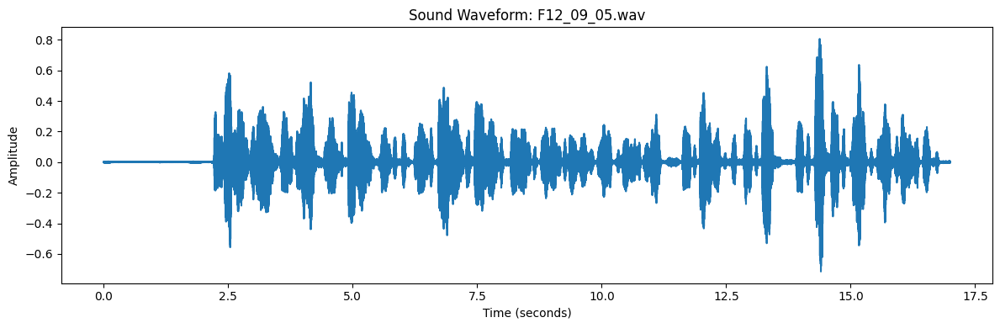

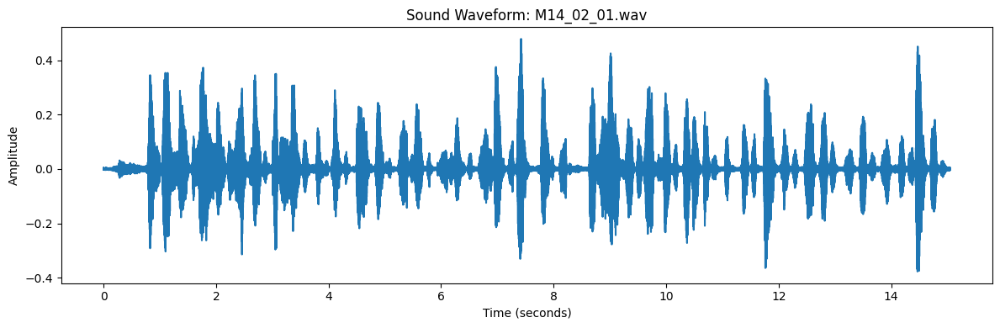

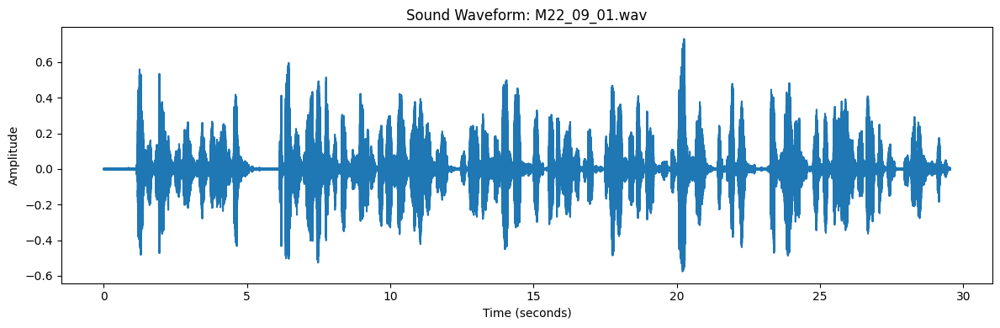

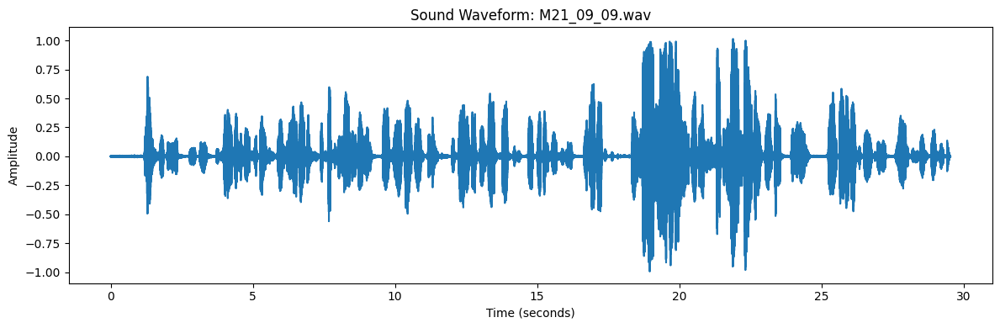

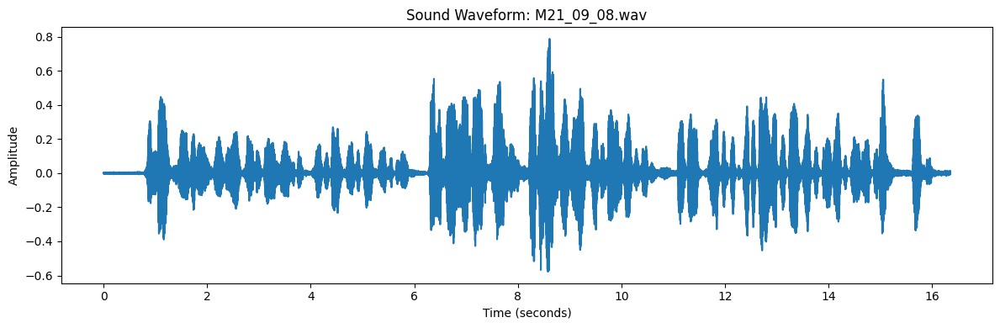

Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/ChildrenAudio


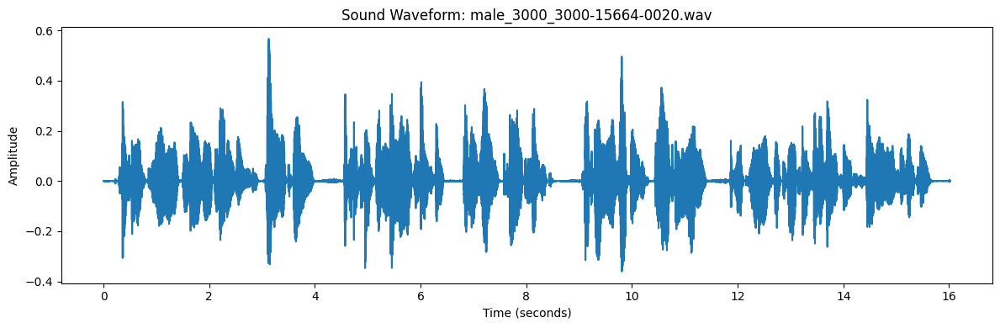

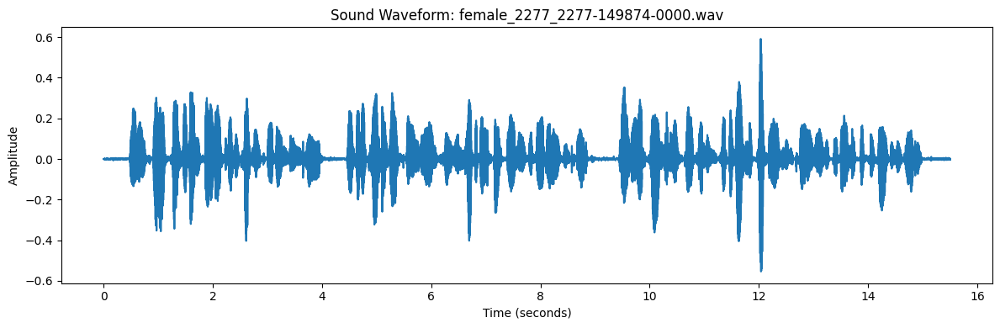

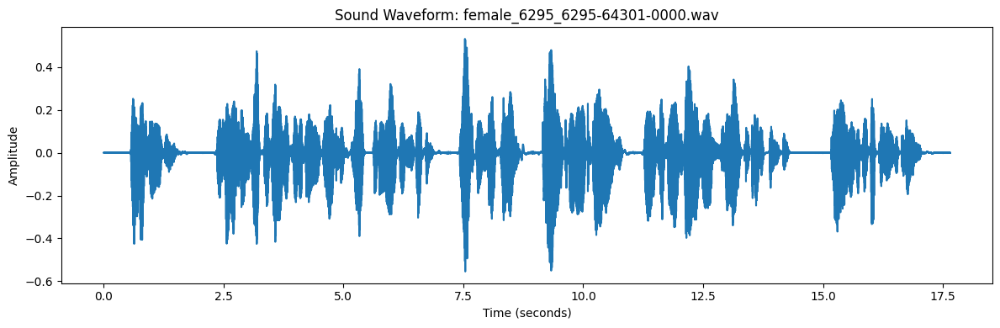

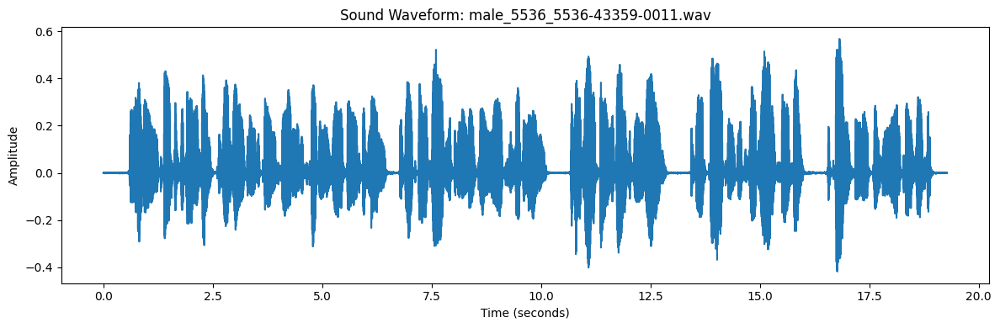

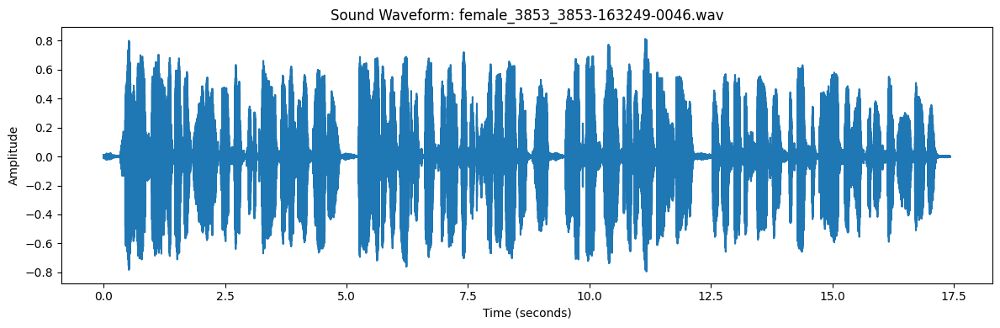

Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/MaleFemaleAudio


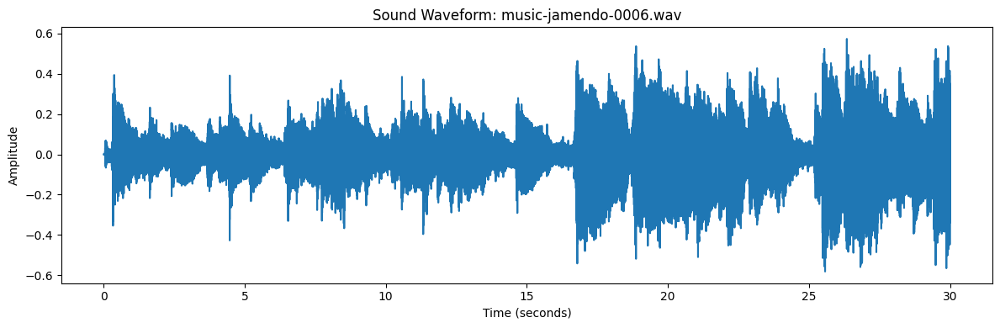

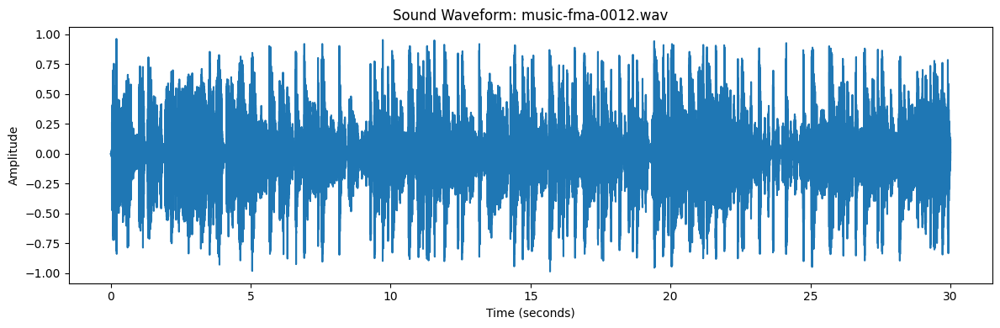

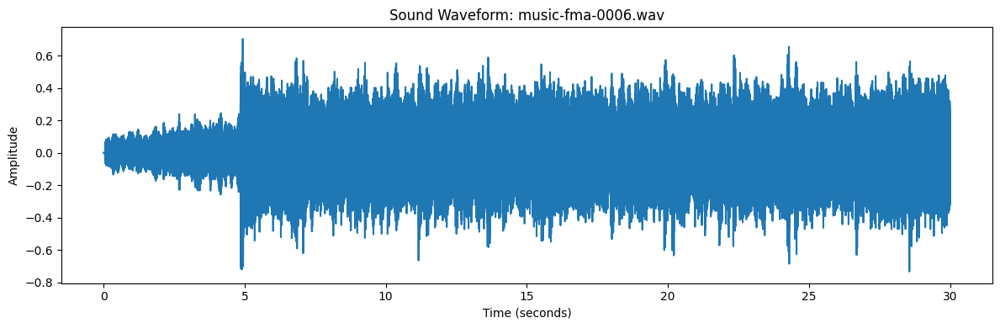

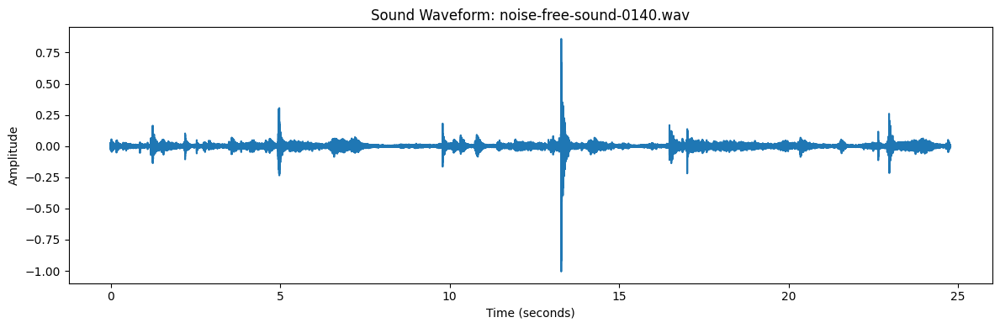

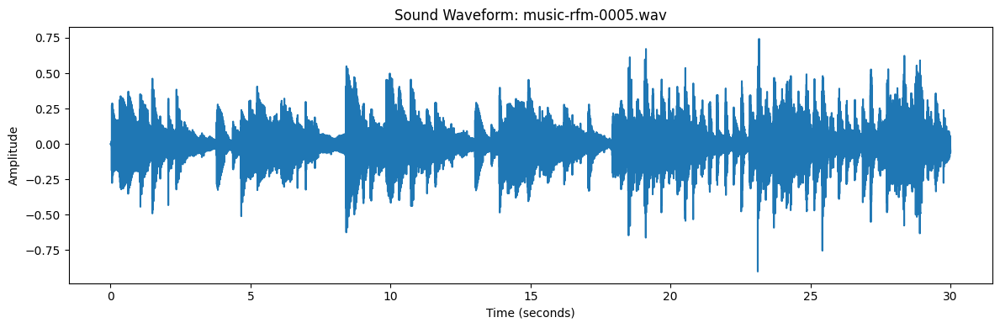

Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/NoisyAudio


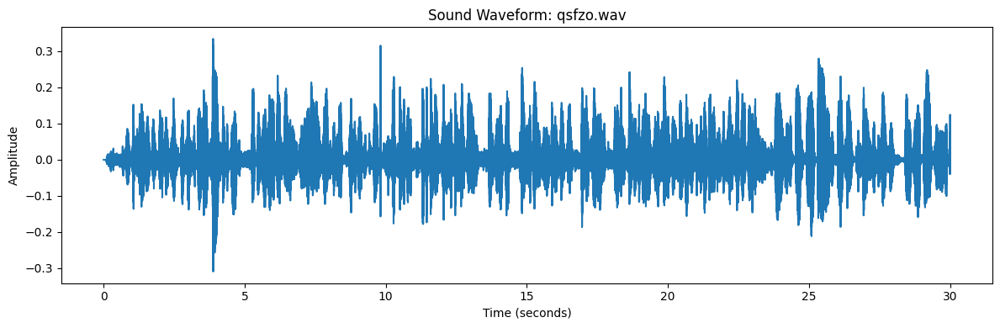

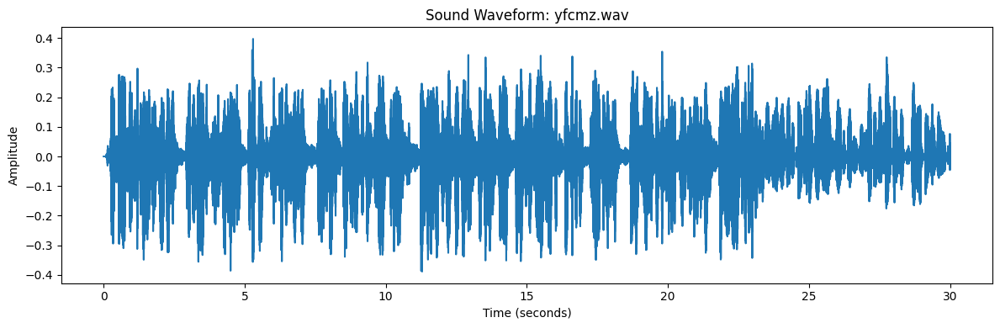

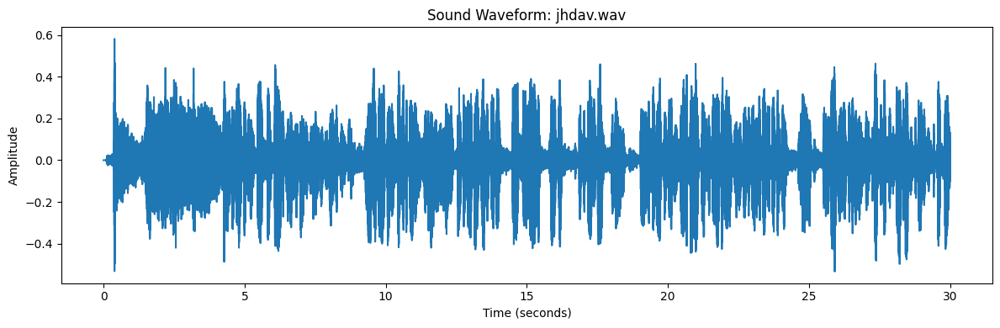

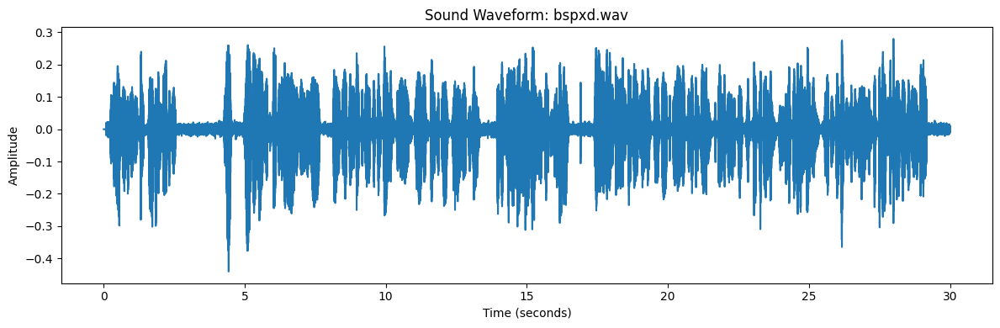

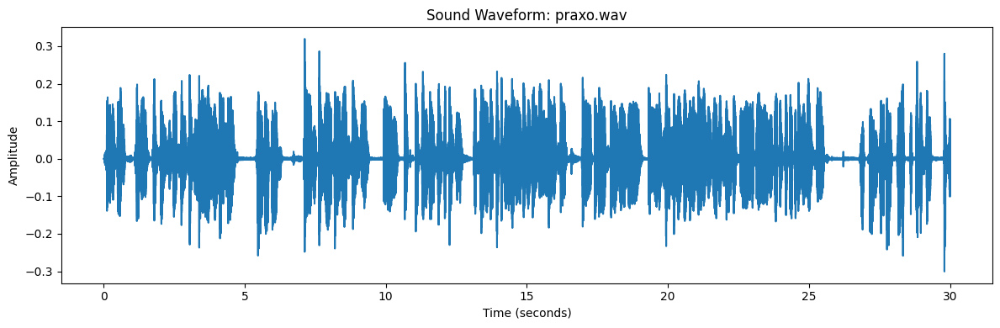

Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/MultipleSpeakers


In [19]:
for subdir in cleaned_data_subdir_paths:
    file_count = 0
    for root, dirs, files in os.walk(subdir):
        for file in files:
            if file.lower().endswith('.wav'):
                file_path = os.path.join(root, file)  # Use 'root' instead of 'subdir'
                
                # Display the audio files
                plot_sound_waveform(file_path)
                
                file_count += 1
                if file_count >= 5:
                    break  # Stop after displaying 5 files
        if file_count >= 5:
            break  # Stop after displaying 5 files from this subdirectory
    print(f"Displayed {file_count} audio files from {subdir}")

## 3.6 All samples were 16 KHz

## 3.7 Signal Generation

In [20]:
import os
import numpy as np
import matplotlib.pyplot as plt
import librosa
from IPython.display import Audio, display

In [21]:
def generate_and_plot_cos_signal(duration, sample_rate, frequency=1000, amplitude=1, num_cycles=2):
    # Generate the full signal
    t_full = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)
    cosine_signal_full = amplitude * np.cos(2 * np.pi * frequency * t_full)
    
    # Generate signal for plotting (two cycles)
    period = 1 / frequency
    t_plot = np.linspace(0, num_cycles * period, int(num_cycles * period * sample_rate), endpoint=False)
    cosine_signal_plot = amplitude * np.cos(2 * np.pi * frequency * t_plot)
    
    # Plot two cycles of the signal
    plt.figure(figsize=(10, 4))
    plt.plot(t_plot, cosine_signal_plot)
    plt.title(f'Cosine Signal ({frequency} Hz) - Two Cycles')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Amplitude')
    plt.grid(True)
    plt.show()
    
    return cosine_signal_full

In [22]:
def process_audio_files(directory_paths, max_files=5):
    for subdir in directory_paths:
        file_count = 0
        for root, dirs, files in os.walk(subdir):
            for file in files:
                if file.lower().endswith('.wav'):
                    file_path = os.path.join(root, file)
                    
                    # Load the audio file
                    audio, sample_rate = librosa.load(file_path, sr=None)
                    duration = len(audio) / sample_rate
                    
                    print(f"Processing file: {file}")
                    print(f"Duration: {duration:.2f} seconds")
                    print(f"Sample rate: {sample_rate} Hz")
                    
                    # Generate and plot cosine signal
                    cosine_signal = generate_and_plot_cos_signal(duration, sample_rate)
                    # Display the original audio
                    print("Original Audio:")
                    display(Audio(audio, rate=sample_rate))
                    
                    # Display the cosine signal
                    print("Cosine Signal:")
                    display(Audio(cosine_signal, rate=sample_rate))
                    
                    
                    print(f"Original audio length: {len(audio)}")
                    print(f"Cosine signal length: {len(cosine_signal)}")
                    
                    print("\n" + "="*50 + "\n")
                    
                    file_count += 1
                    if file_count >= max_files:
                        break  # Stop after displaying max_files
            if file_count >= max_files:
                break  # Stop after displaying max_files from this subdirectory
        print(f"Displayed {file_count} audio files from {subdir}")

Processing file: F12_09_05.wav
Duration: 17.00 seconds
Sample rate: 16000 Hz


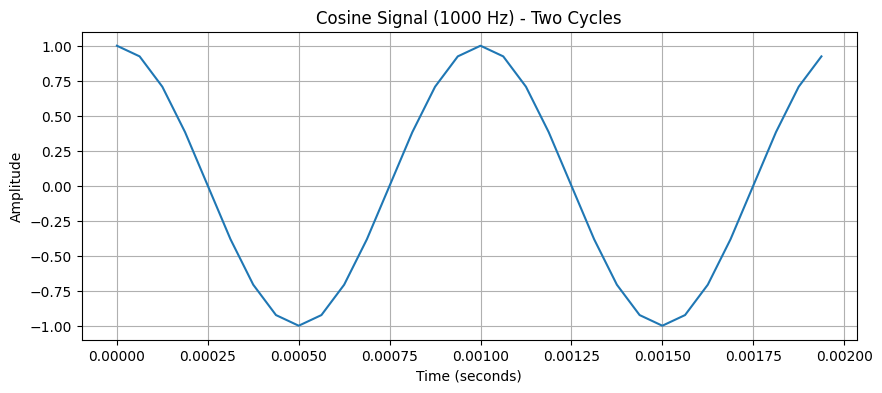

Original Audio:


Cosine Signal:


Original audio length: 271952
Cosine signal length: 271952


Processing file: M14_02_01.wav
Duration: 15.05 seconds
Sample rate: 16000 Hz


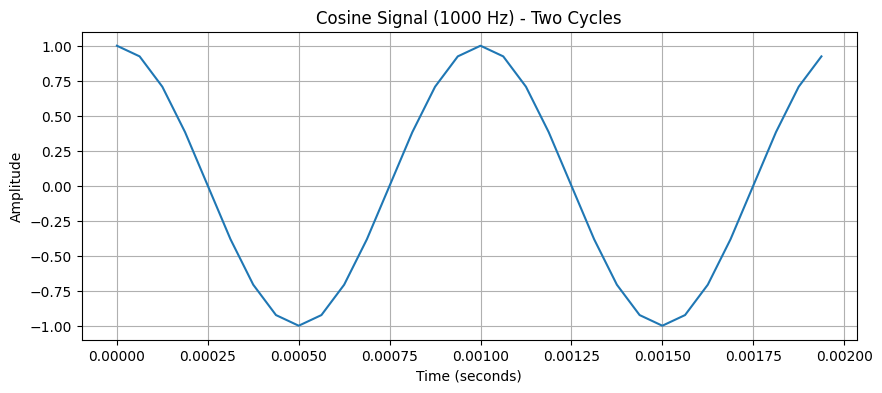

Original Audio:


Cosine Signal:


Original audio length: 240752
Cosine signal length: 240752


Processing file: M22_09_01.wav
Duration: 29.54 seconds
Sample rate: 16000 Hz


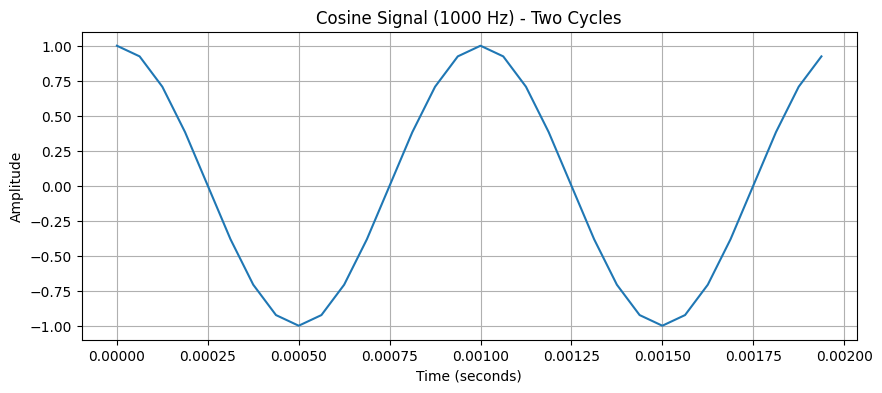

Original Audio:


Cosine Signal:


Original audio length: 472576
Cosine signal length: 472576


Processing file: M21_09_09.wav
Duration: 29.54 seconds
Sample rate: 16000 Hz


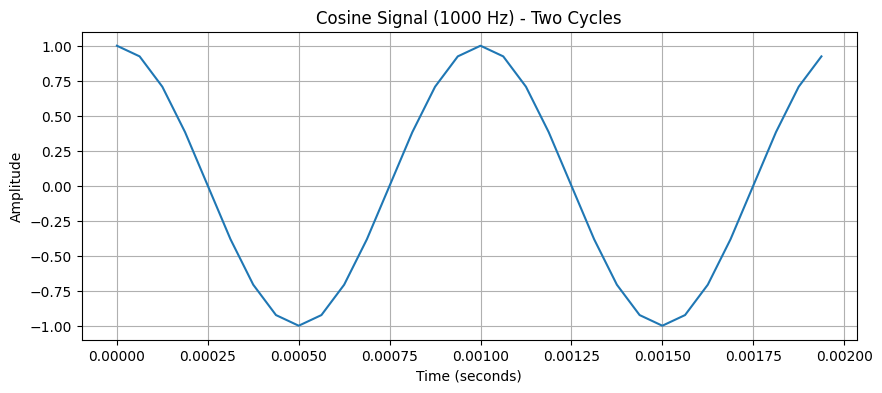

Original Audio:


Cosine Signal:


Original audio length: 472576
Cosine signal length: 472576


Processing file: M21_09_08.wav
Duration: 16.35 seconds
Sample rate: 16000 Hz


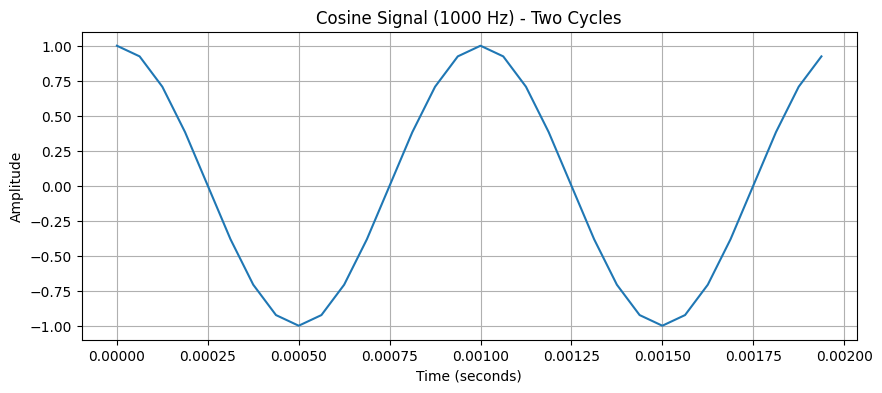

Original Audio:


Cosine Signal:


Original audio length: 261552
Cosine signal length: 261552


Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/ChildrenAudio
Processing file: male_3000_3000-15664-0020.wav
Duration: 16.02 seconds
Sample rate: 16000 Hz


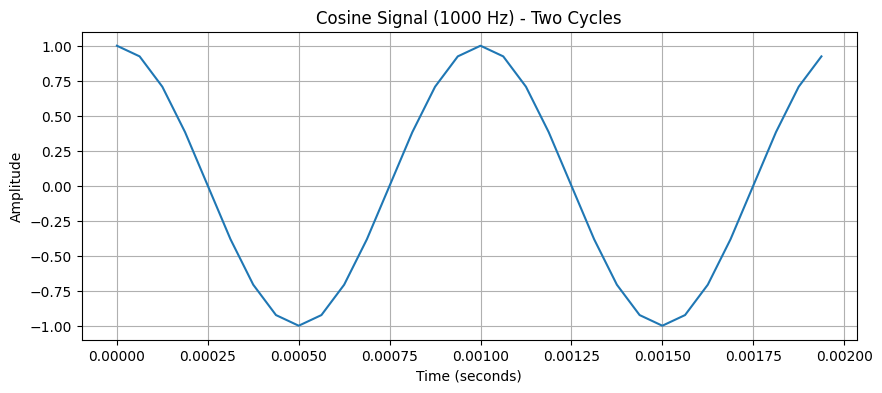

Original Audio:


Cosine Signal:


Original audio length: 256320
Cosine signal length: 256320


Processing file: female_2277_2277-149874-0000.wav
Duration: 15.51 seconds
Sample rate: 16000 Hz


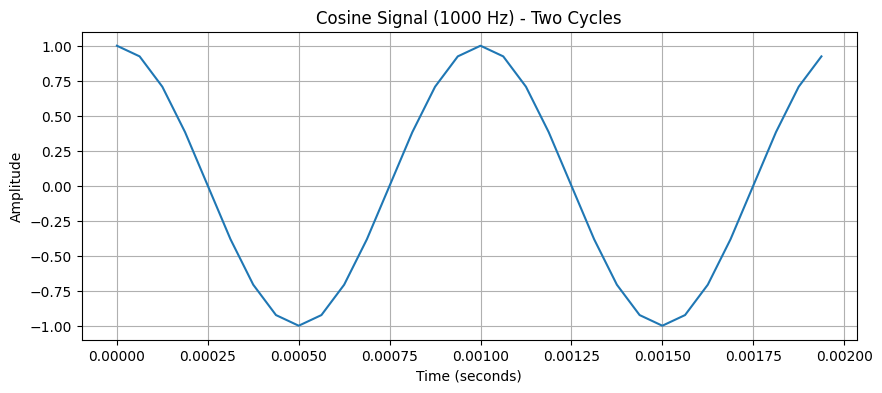

Original Audio:


Cosine Signal:


Original audio length: 248080
Cosine signal length: 248080


Processing file: female_6295_6295-64301-0000.wav
Duration: 17.65 seconds
Sample rate: 16000 Hz


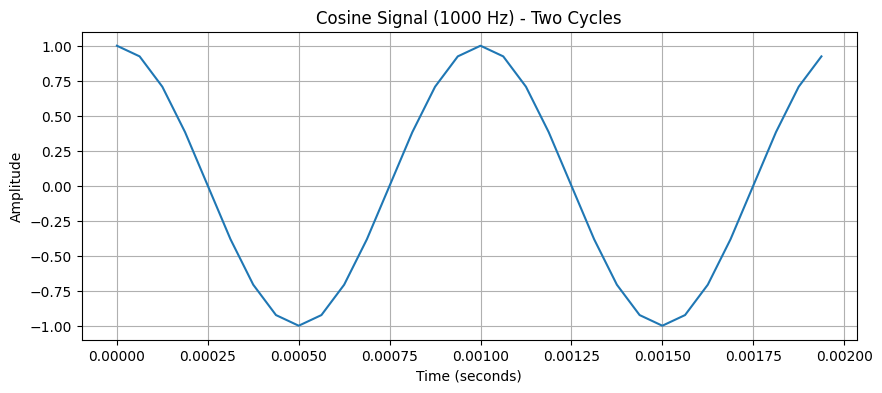

Original Audio:


Cosine Signal:


Original audio length: 282400
Cosine signal length: 282400


Processing file: male_5536_5536-43359-0011.wav
Duration: 19.27 seconds
Sample rate: 16000 Hz


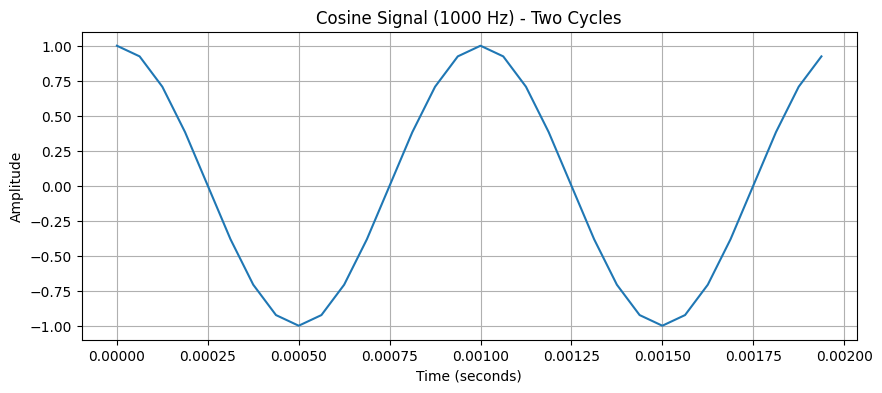

Original Audio:


Cosine Signal:


Original audio length: 308400
Cosine signal length: 308400


Processing file: female_3853_3853-163249-0046.wav
Duration: 17.43 seconds
Sample rate: 16000 Hz


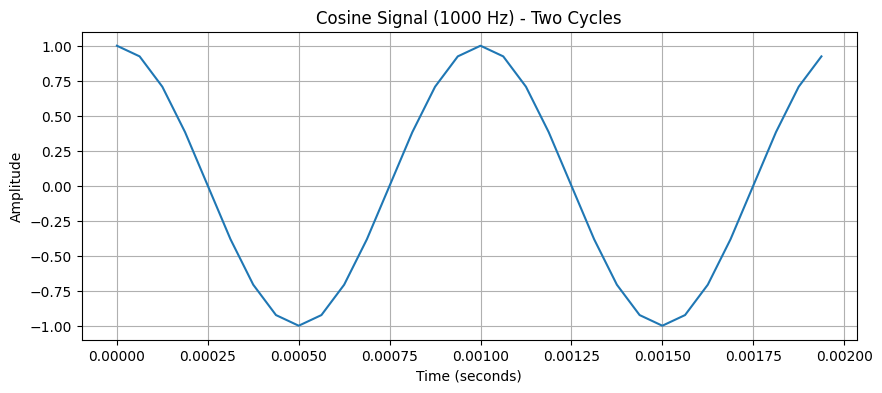

Original Audio:


Cosine Signal:


Original audio length: 278831
Cosine signal length: 278831


Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/MaleFemaleAudio
Processing file: music-jamendo-0006.wav
Duration: 30.00 seconds
Sample rate: 16000 Hz


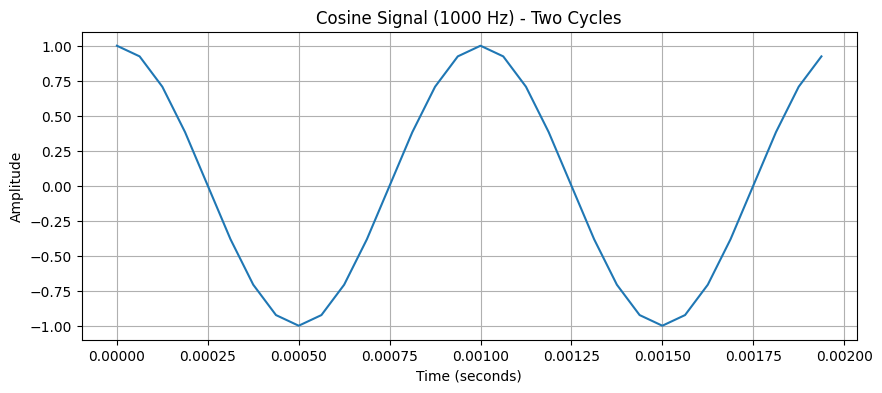

Original Audio:


Cosine Signal:


Original audio length: 480000
Cosine signal length: 480000


Processing file: music-fma-0012.wav
Duration: 30.00 seconds
Sample rate: 16000 Hz


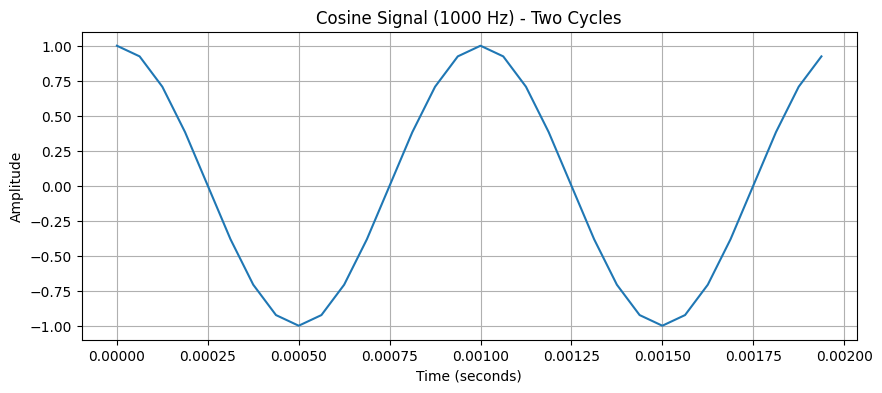

Original Audio:


Cosine Signal:


Original audio length: 480000
Cosine signal length: 480000


Processing file: music-fma-0006.wav
Duration: 30.00 seconds
Sample rate: 16000 Hz


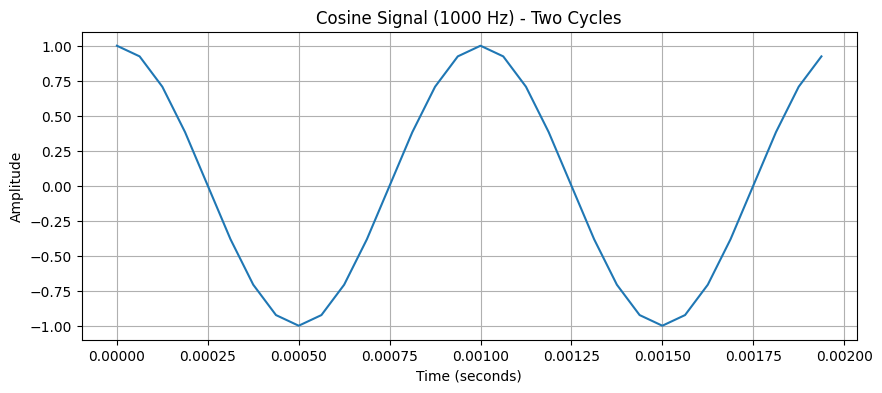

Original Audio:


Cosine Signal:


Original audio length: 480000
Cosine signal length: 480000


Processing file: noise-free-sound-0140.wav
Duration: 24.77 seconds
Sample rate: 16000 Hz


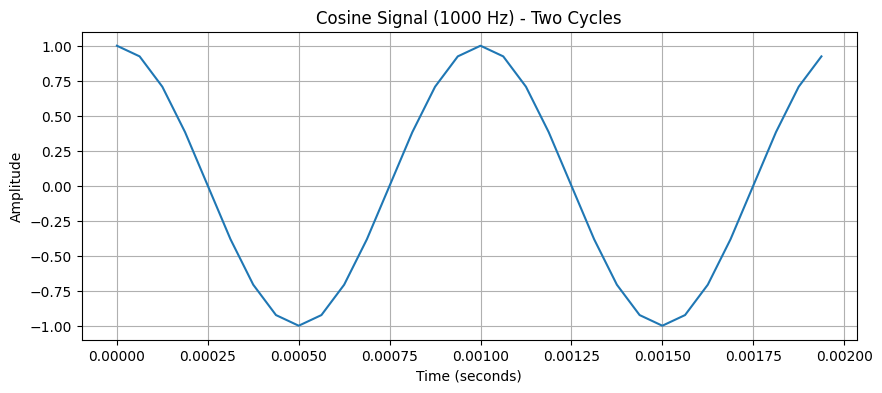

Original Audio:


Cosine Signal:


Original audio length: 396400
Cosine signal length: 396400


Processing file: music-rfm-0005.wav
Duration: 30.00 seconds
Sample rate: 16000 Hz


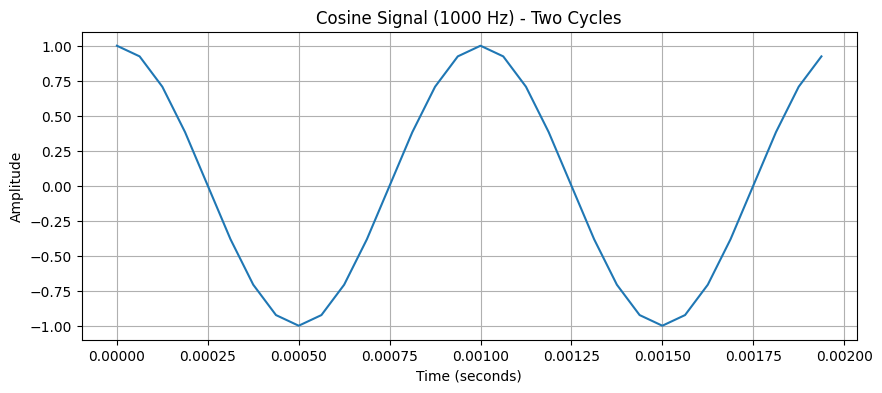

Original Audio:


Cosine Signal:


Original audio length: 480000
Cosine signal length: 480000


Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/NoisyAudio
Processing file: qsfzo.wav
Duration: 30.00 seconds
Sample rate: 16000 Hz


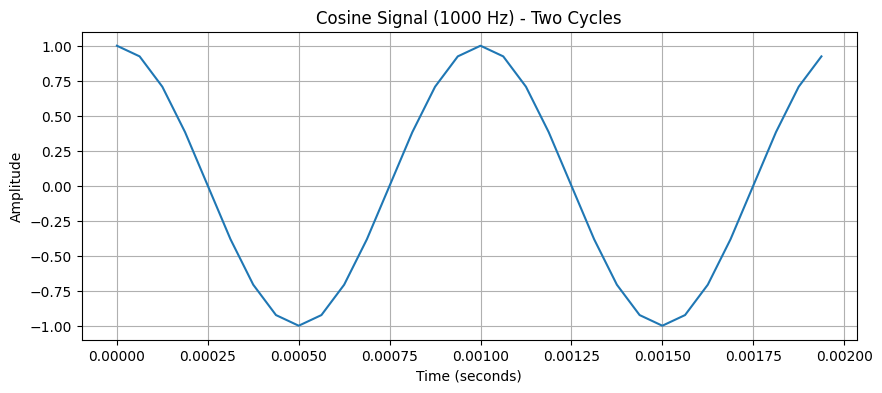

Original Audio:


Cosine Signal:


Original audio length: 480000
Cosine signal length: 480000


Processing file: yfcmz.wav
Duration: 30.00 seconds
Sample rate: 16000 Hz


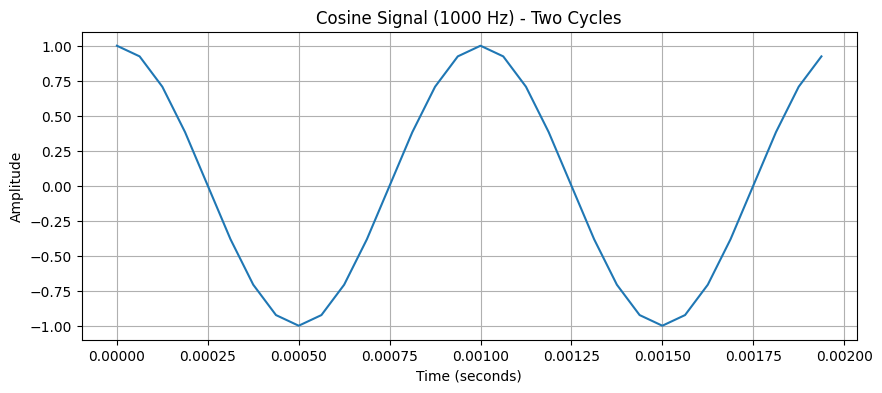

Original Audio:


Cosine Signal:


Original audio length: 480000
Cosine signal length: 480000


Processing file: jhdav.wav
Duration: 30.00 seconds
Sample rate: 16000 Hz


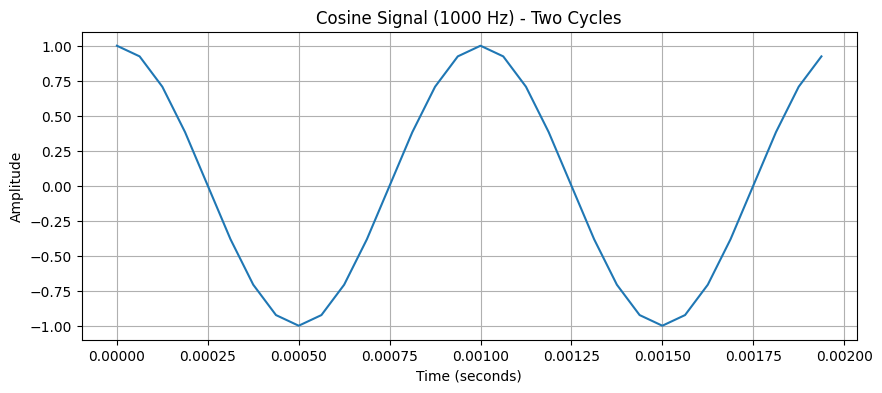

Original Audio:


Cosine Signal:


Original audio length: 480000
Cosine signal length: 480000


Processing file: bspxd.wav
Duration: 30.00 seconds
Sample rate: 16000 Hz


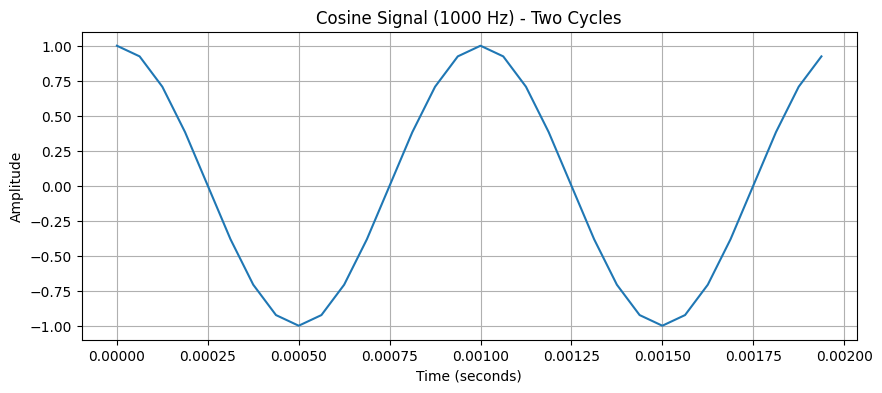

Original Audio:


Cosine Signal:


Original audio length: 480000
Cosine signal length: 480000


Processing file: praxo.wav
Duration: 30.00 seconds
Sample rate: 16000 Hz


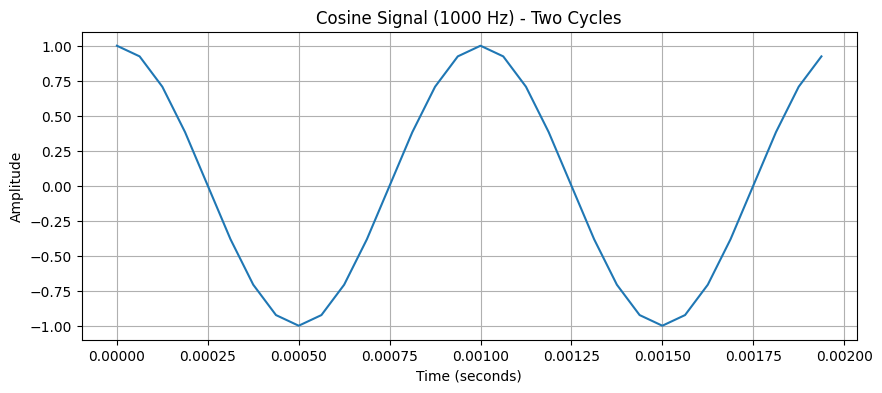

Original Audio:


Cosine Signal:


Original audio length: 480000
Cosine signal length: 480000


Displayed 5 audio files from /Users/alexszabo/MTE/2B/MTE252/Projects/MTE252-P01/data/cleaned_dataset/MultipleSpeakers


In [23]:
process_audio_files(cleaned_data_subdir_paths)